<a href="https://colab.research.google.com/github/MAEV-David/Concrete_Crack_Detection/blob/main/Crack_Detection_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[**Crack Detection** From *priya-dwivedi*](https://github.com/priya-dwivedi/Deep-Learning/tree/master/crack_detection)

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torch.optim import lr_scheduler
from torchvision import datasets, models, transforms
import torchvision
import numpy as np
import pandas as pd 
import os
cwd = os.getcwd()
from PIL import Image
import time
import copy
import random
import cv2
import re
import shutil
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc

In [ ]:
PATH = '/content/drive/MyDrive/Colab Notebooks/Concrete Crack Images for Classification/'

# **Load the Cracks Data set and Visualize it**
Link to the cracks data set: https://data.mendeley.com/datasets/5y9wdsg2zt/2
Download the data set and unzip it in the same folder as this notebook

In [ ]:
crack_images = os.listdir(PATH + 'Positive/')
print("Number of Crack Images: ", len(crack_images))

FileNotFoundError: ignored

In [ ]:
no_crack_images = os.listdir(PATH + 'Negative/')
print("Number of No Crack Images: ", len(no_crack_images))

In [ ]:
## Visualize Random images with cracks
random_indices = np.random.randint(0, len(crack_images), size=4)
print("*****************Random Images with Cracks**************************")
random_images = np.array(crack_images)[random_indices.astype(int)]

f, ax = plt.subplots(2,2)
ax[0,0].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Positive', random_images[0])))
ax[0,1].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Positive', random_images[1])))
ax[1,0].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Positive', random_images[2])))
ax[1,1].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Positive', random_images[3])))

*****************Random Images without Cracks**************************


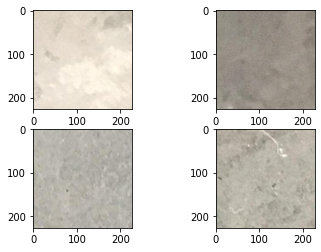

In [ ]:
## Visualize Random images with no cracks
random_indices = np.random.randint(0, len(no_crack_images), size=4)
print("*****************Random Images without Cracks**************************")
random_images = np.array(no_crack_images)[random_indices.astype(int)]

f, ax = plt.subplots(2,2)
ax[0,0].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Negative', random_images[0])))
ax[0,1].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Negative', random_images[1])))
ax[1,0].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Negative', random_images[2])))
ax[1,1].imshow(mpimg.imread(os.path.join(cwd, PATH + 'Negative', random_images[3])))

# **Create Train and Val Data sets**
## Create training folder

In [ ]:
base_dir = PATH
files = os.listdir(base_dir)

def create_training_data(folder_name):
    train_dir = f"{base_dir}/train/{folder_name}"
    for f in files:
        search_object = re.search(folder_name, f)
        if search_object:
            shutil.move(f'{base_dir}/{folder_name}', train_dir)

create_training_data('Positive')
create_training_data('Negative')

## **Move images randomly from training to val folders**

In [ ]:
os.makedirs(PATH + 'val/Positive')
os.makedirs(PATH + 'val/Negative')

In [ ]:
positive_train = base_dir + "train/Positive/"
positive_val = base_dir + "val/Positive/"
negative_train = base_dir + "train/Negative/"
negative_val = base_dir + "val/Negative/"

positive_files = os.listdir(positive_train)
negative_files = os.listdir(negative_train)

In [ ]:
print(len(positive_files), len(negative_files))

20000 20000


In [ ]:
for f in positive_files:
    if random.random() > 0.80:
        shutil.move(f'{positive_train}/{f}', positive_val)

In [ ]:
for f in negative_files:
    if random.random() > 0.80:
        shutil.move(f'{negative_train}/{f}', negative_val)

# **Pytorch data loader and transforms**


## Compute mean and std deviation for the dataset

[pytorch torchvision transform](https://blog.csdn.net/qq_38410428/article/details/94719553)

In [ ]:
mean_nums = [0.485, 0.456, 0.406]
std_nums = [0.229, 0.224, 0.225]

In [ ]:
## Define data augmentation and transforms
chosen_transforms = {
    'train': transforms.Compose([
        transforms.RandomResizedCrop(size=227),
        transforms.RandomRotation(degrees=10),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.15, contrast=0.15),
        transforms.ToTensor(),
        transforms.Normalize(mean_nums, std_nums)]), 
    'val': transforms.Compose([
        transforms.Resize(227),
        transforms.CenterCrop(227),
        transforms.ToTensor(),
        transforms.Normalize(mean_nums, std_nums)]),
}

In [ ]:
## Create the data loader
def load_dataset(format, batch_size):
    data_path = os.path.join(PATH, format)
    dataset = datasets.ImageFolder(root=data_path, 
                                   transform= chosen_transforms[format])
    data_loader = DataLoader(dataset,
                             batch_size=batch_size,
                             num_workers=4,
                             shuffle=True)
    return data_loader, len(dataset), dataset.classes

In [ ]:
## Set code to run on device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
train_loader, train_size, class_names = load_dataset('train', 8)
print("Train Data Set size is: ", train_size)
print("Class Names are: ", class_names)
inputs, classes = next(iter(train_loader))
print(inputs.shape, classes.shape)

Train Data Set size is:  31953
Class Names are:  ['Negative', 'Positive']


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


torch.Size([8, 3, 227, 227]) torch.Size([8])


## Visualize the Augmented Data Set

In [ ]:
# Visualize some images
def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([mean_nums])
    std = np.array([std_nums])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # Pause a bit so that plots are updated

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


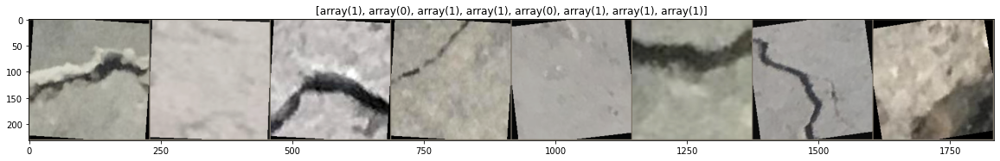

In [ ]:
# Grab some of the training data to visualize
inputs, classes = next(iter(train_loader))
# class_names = chosen_datasets['train'].classes
# Now we construct a grid from batch
out = torchvision.utils.make_grid(inputs)

idx_to_class = {0:'Negative', 1:'Positive'}
plt.figure(figsize=(20,10))
imshow(out, title=[x.data.numpy() for x in classes])

# **Set up Pretrained Model**

[使用Pre-training的方法與時機](https://medium.com/%E8%BB%9F%E9%AB%94%E4%B9%8B%E5%BF%83/deep-learning-%E4%BD%BF%E7%94%A8pre-training%E7%9A%84%E6%96%B9%E6%B3%95%E8%88%87%E6%99%82%E6%A9%9F-b0ef14e777e9)

In [ ]:
## Load pretrained model
resnet50 = models.resnet50(pretrained=True)

# Freeze model parameters
for param in resnet50.parameters():
    param.requires_grad = False

## Change the final layer of the resnet model
# Change the final layer of ResNet50 Model for Transfer Learning
fc_inputs = resnet50.fc.in_features
 
resnet50.fc = nn.Sequential(
    nn.Linear(fc_inputs, 128),
    nn.ReLU(),
    nn.Dropout(0.4),
    nn.Linear(128, 2)
)

# Convert model to be used on GPU
resnet50 = resnet50.to(device)

from torchsummary import summary
print(summary(resnet50, (3, 227, 227)))

Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth



----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 114, 114]           9,408
       BatchNorm2d-2         [-1, 64, 114, 114]             128
              ReLU-3         [-1, 64, 114, 114]               0
         MaxPool2d-4           [-1, 64, 57, 57]               0
            Conv2d-5           [-1, 64, 57, 57]           4,096
       BatchNorm2d-6           [-1, 64, 57, 57]             128
              ReLU-7           [-1, 64, 57, 57]               0
            Conv2d-8           [-1, 64, 57, 57]          36,864
       BatchNorm2d-9           [-1, 64, 57, 57]             128
             ReLU-10           [-1, 64, 57, 57]               0
           Conv2d-11          [-1, 256, 57, 57]          16,384
      BatchNorm2d-12          [-1, 256, 57, 57]             512
           Conv2d-13          [-1, 256, 57, 57]          16,384
      BatchNorm2d-14          [-1, 256

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [ ]:
# Define Optimizer and Loss Function
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(resnet50.parameters())
# optimizer = optim.SGD(resnet50.fc.parameters(), lr=0.001, momentum=0.9)
# Decay LR by a factor of 0.1 every 3 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

In [ ]:
dataloaders = {}
dataset_sizes = {}
batch_size = 256
dataloaders['train'], dataset_sizes['train'], class_names = load_dataset('train', batch_size)
dataloaders['val'], dataset_sizes['val'], _ = load_dataset('val', batch_size)
idx_to_class = {0:'Negative', 1:'Positive'}

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


# **Start training**

In [ ]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=10):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    # train history
    column_names=['Epoch','accuracy','val_accuracy','loss','val_loss']
    index = [_ for _ in range(num_epochs)]
    train_history = pd.DataFrame(columns = column_names, index = index)

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)
        train_history['Epoch'][epoch] = epoch

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            current_loss = 0.0
            current_corrects = 0
            tot_loss = 0.0
            tot_acc = 0.0
            train_preds = []
            train_trues = []

            # Here's where the training happens
            print('Iterating through data...')

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # We need to zero the gradients, don't forget it
                optimizer.zero_grad()

                # Time to carry out the forward training poss
                # We only need to log the loss stats if we are in training phase
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()
                        

                # We want variables to hold the loss statistics
                current_loss += loss.item() * inputs.size(0)
                current_corrects += torch.sum(preds == labels.data)

                #累加每個step的損失--test--
                tot_loss += loss.data
                train_outputs = outputs.argmax(dim=1)

                train_preds.extend(train_outputs.detach().cpu().numpy())
                train_trues.extend(labels.detach().cpu().numpy())
                # --test--
            # --test--
            sklearn_accuracy = accuracy_score(train_trues, train_preds) 
            sklearn_precision = precision_score(train_trues, train_preds, average='micro')
            sklearn_recall = recall_score(train_trues, train_preds, average='micro')
            sklearn_f1 = f1_score(train_trues, train_preds, average='micro')
            print("[metrics] Epoch:{} loss:{:.4f} accuracy:{:.4f} precision:{:.4f} recall:{:.4f} f1:{:.4f}".format(epoch, tot_loss, sklearn_accuracy, sklearn_precision, sklearn_recall, sklearn_f1))
            # --test--

            epoch_loss = current_loss / dataset_sizes[phase]
            epoch_acc = current_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))
            
            if phase == 'train':
                train_history['accuracy'][epoch] = epoch_acc
                train_history['loss'][epoch] = epoch_loss
            else:
                train_history['val_accuracy'][epoch] = epoch_acc
                train_history['val_loss'][epoch] = epoch_loss

            # Make a copy of the model if the accuracy on the validation set has improved
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_since = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_since // 60, time_since % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # Now we'll load in the best model weights and return it
    model.load_state_dict(best_model_wts)
    return model, train_history

In [ ]:
def visualize_model(model, num_images=6):
    test_preds = []
    test_trues = []
    was_training = model.training
    model.eval()
    images_handeled = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.float().to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            outputs = outputs.argmax(dim=1)
            test_preds.extend(outputs.detach().cpu().numpy())
            test_trues.extend(labels.detach().cpu().numpy())


            # --test--
            sklearn_precision = precision_score(test_trues, test_preds, average='micro')
            sklearn_recall = recall_score(test_trues, test_preds, average='micro')
            sklearn_f1 = f1_score(test_trues, test_preds, average='micro')
            print(classification_report(test_trues, test_preds))
            # get_roc_auc(label_binarize(test_trues, classes=[i for i in range(2)]), label_binarize(test_preds, classes=[i for i in range(2)]))
            conf_matrix = get_confusion_matrix(test_trues, test_preds)
            print(conf_matrix)
            plot_confusion_matrix(conf_matrix)
            print("[metrics] accuracy:{:.4f} precision:{:.4f} recall:{:.4f} f1:{:.4f}".format(sklearn_accuracy, sklearn_precision, sklearn_recall, sklearn_f1))
            

            for j in range(inputs.size()[0]):
                images_handeled += 1
                ax = plt.subplot(num_images//2, 2, images_handeled)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_handeled == num_images:
                    model.train(mode=was_training)
                    return

        model.train(mode=was_training)

> **訓練結果用 matplotlib 繪製圖形**

In [ ]:
def show_train_history(train_history):
    fig=plt.gcf()
    fig.set_size_inches(16, 6)
    plt.subplot(121)
    plt.plot(train_history["accuracy"])
    plt.plot(train_history["val_accuracy"])
    plt.title("Train History")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend(["train", "validation"], loc="upper left")
    plt.subplot(122)
    plt.plot(train_history["loss"])
    plt.plot(train_history["val_loss"])
    plt.title("Train History")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend(["train", "validation"], loc="upper left")
    plt.show()

-  [一文弄懂pytorch搭建網絡流程+多分類評價指標](https://codingnote.cc/zh-hk/p/383297/)

- [The power of transfer learning with FASTAI: Crack Detection in Concrete Structure](https://medium.com/swlh/the-power-of-transfer-learning-with-fastai-crack-detection-in-concrete-structure-4a36a7ad8a01)

In [ ]:
def get_confusion_matrix(trues, preds):
  labels = [0, 1]
  conf_matrix = confusion_matrix(trues, preds, labels)
  return conf_matrix

def get_roc_auc(trues, preds):
  labels = ['Positive','Negative']
  labels = [0,1]
  nb_classes = len(labels)
  fpr = dict()
  tpr = dict()
  roc_auc = dict()
  print(trues, preds)
  for i in range(nb_classes):
    fpr[i], tpr[i], _ = roc_curve(trues[:, i], preds[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    # Compute micro-average ROC curve and ROC area
  fpr["micro"], tpr["micro"], _ = roc_curve(trues.ravel(), preds.ravel())
  roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])
  # First aggregate all false positive rates
  all_fpr = np.unique(np.concatenate([fpr[i] for i in range(nb_classes)]))
  # Then interpolate all ROC curves at this points
  mean_tpr = np.zeros_like(all_fpr)
  for i in range(nb_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])
  # Finally average it and compute AUC
  mean_tpr /= nb_classes
  fpr["macro"] = all_fpr
  tpr["macro"] = mean_tpr
  roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])
  # Plot all ROC curves
  lw = 2
  plt.figure()
  plt.plot(fpr["micro"], tpr["micro"],label='micro-average ROC curve (area = {0:0.2f})'.format(roc_auc["micro"]),color='deeppink', linestyle=':', linewidth=4)
  plt.plot(fpr["macro"], tpr["macro"],label='macro-average ROC curve (area = {0:0.2f})'.format(roc_auc["macro"]),color='navy', linestyle=':', linewidth=4)
  colors = cycle(['aqua', 'darkorange', 'cornflowerblue'])
  for i, color in zip(range(nb_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw, label='ROC curve of class {0} (area = {1:0.2f})'.format(i, roc_auc[i]))
  plt.plot([0, 1], [0, 1], 'k--', lw=lw)
  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.05])
  plt.xlabel('False Positive Rate')
  plt.ylabel('True Positive Rate')
  plt.title('Some extension of Receiver operating characteristic to multi-class')
  plt.legend(loc="lower right")
  plt.savefig("ROC_10分類.png")
  plt.show()
  
#test_trues = label_binarize(test_trues, classes=[i for i in range(2)])
#test_preds = label_binarize(test_preds, classes=[i for i in range(2)])
#get_roc_auc(test_trues, test_preds)
  
def plot_confusion_matrix(conf_matrix):
  plt.imshow(conf_matrix, cmap=plt.cm.Greens)
  indices = range(conf_matrix.shape[0])
  labels = ['Negative','Positive']
  plt.xticks(indices, labels)
  plt.yticks(indices, labels)
  plt.colorbar()
  plt.xlabel('Predicted')
  plt.ylabel('Actual')
  plt.title('Confusion Matrix')
  # 顯示數據
  for first_index in range(conf_matrix.shape[0]):
    for second_index in range(conf_matrix.shape[1]):
      plt.text(first_index, second_index, conf_matrix[first_index, second_index])
  plt.savefig('heatmap_confusion_matrix.jpg')
  plt.show()

Epoch 0/9
----------
Iterating through data...


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


[metrics] Epoch:0 loss:20.8999 accuracy:0.9382 precision:0.9382 recall:0.9382 f1:0.9382
train Loss: 0.1672 Acc: 0.9382
Iterating through data...
[metrics] Epoch:0 loss:1.8740 accuracy:0.9825 precision:0.9825 recall:0.9825 f1:0.9825
val Loss: 0.0589 Acc: 0.9825

Epoch 1/9
----------
Iterating through data...
[metrics] Epoch:1 loss:20.9304 accuracy:0.9380 precision:0.9380 recall:0.9380 f1:0.9380
train Loss: 0.1674 Acc: 0.9380
Iterating through data...
[metrics] Epoch:1 loss:1.8815 accuracy:0.9825 precision:0.9825 recall:0.9825 f1:0.9825
val Loss: 0.0590 Acc: 0.9825

Epoch 2/9
----------
Iterating through data...
[metrics] Epoch:2 loss:20.7194 accuracy:0.9393 precision:0.9393 recall:0.9393 f1:0.9393
train Loss: 0.1658 Acc: 0.9393
Iterating through data...
[metrics] Epoch:2 loss:1.9338 accuracy:0.9820 precision:0.9820 recall:0.9820 f1:0.9820
val Loss: 0.0595 Acc: 0.9820

Epoch 3/9
----------
Iterating through data...
[metrics] Epoch:3 loss:20.7262 accuracy:0.9386 precision:0.9386 recall:0.

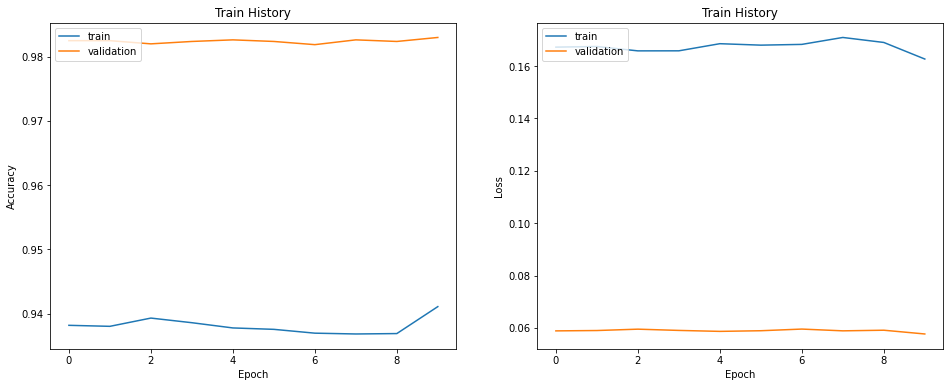

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


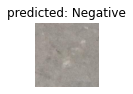

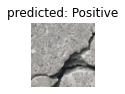

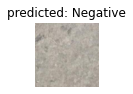

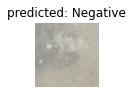

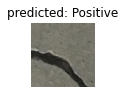

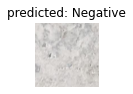

In [ ]:
base_model, train_history = train_model(resnet50, criterion, optimizer, exp_lr_scheduler, num_epochs=10)
#show train history
print(train_history)
show_train_history(train_history)
# 輸出照片
visualize_model(base_model)
plt.show()

### 儲存模型


[pytorch資料載入、模型儲存及載入](https://www.itread01.com/content/1546092606.html)

[模型載入與儲存](https://iter01.com/529017.html)

In [ ]:
# 儲存 train_history
localtime = time.strftime("%Y-%m-%d", time.localtime()) 
train_history.to_csv(PATH + 'train_history_'+ localtime +'.csv')

NameError: ignored

In [ ]:
train_history = pd.read_csv(PATH + 'train_history_'+ '2021-06-11_1' +'.csv')  
print(train_history)

   Unnamed: 0  Epoch  accuracy  val_accuracy      loss  val_loss
0           0      0    0.9207        0.9758  0.220815  0.079858
1           1      1    0.9335        0.9794  0.182241  0.071526
2           2      2    0.9366        0.9815  0.177349  0.066147
3           3      3    0.9357        0.9841  0.177633  0.060182
4           4      4    0.9347        0.9824  0.177339  0.061930
5           5      5    0.9384        0.9822  0.171186  0.061257
6           6      6    0.9369        0.9822  0.171536  0.061078


NameError: ignored

In [ ]:
# 儲存整個模型
print('===> Saving models...')
localtime = time.strftime("%Y-%m-%d", time.localtime()) 
torch.save(base_model, PATH + 'Save_File_Crack_Detection_model_'+ localtime +'.pth')
# 儲存 train_history
localtime = time.strftime("%Y-%m-%d", time.localtime()) 
train_history.to_csv(PATH + 'train_history_'+ localtime +'.csv')
"""
# 儲存模型引數
base_model_state_dict = base_model.state_dict()
torch.save(base_model_state_dict, PATH + 'Save_File_Crack_Detection_state_dict_'+ str(localtime) +'.pth')
"""

===> Saving models...


"\n# 儲存模型引數\nbase_model_state_dict = base_model.state_dict()\ntorch.save(base_model_state_dict, PATH + 'Save_File_Crack_Detection_state_dict_'+ str(localtime) +'.pth')\n"

# **Inference**

### 載入訓練好的模型

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


              precision    recall  f1-score   support

           0       0.97      0.98      0.98       122
           1       0.98      0.97      0.98       134

    accuracy                           0.98       256
   macro avg       0.98      0.98      0.98       256
weighted avg       0.98      0.98      0.98       256

[[120   2]
 [  4 130]]


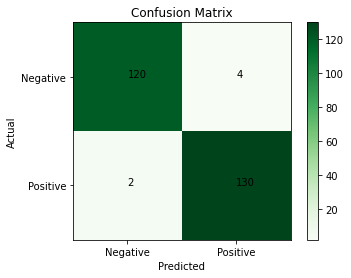

NameError: ignored

In [ ]:
# 載入訓練好的模型
modeltime = '2021-06-05'
# cuba版本
base_model = torch.load(PATH + 'Save_File_Crack_Detection_model_'+ modeltime +'.pth')
# cpu版本
# base_model = torch.load(PATH + 'Save_File_Crack_Detection_model_'+ modeltime +'.pth', map_location='cpu')

# 輸出照片
visualize_model(base_model)
plt.show()

In [ ]:
def predict(model, test_image, print_class = False):
     
    transform = chosen_transforms['val']
     
    test_image_tensor = transform(test_image)
 
    if torch.cuda.is_available():
        test_image_tensor = test_image_tensor.view(1, 3, 227, 227).cuda()
    else:
        test_image_tensor = test_image_tensor.view(1, 3, 227, 227)
     
    with torch.no_grad():
        model.eval()
        # Model outputs log probabilities
        out = model(test_image_tensor)
        ps = torch.exp(out)
        topk, topclass = ps.topk(1, dim=1)
        class_name = idx_to_class[topclass.cpu().numpy()[0][0]]
        if print_class:
            print("Output class :  ", class_name)
    return class_name

In [ ]:
def predict_on_crops(input_image, height=227, width=227, save_crops = False):
    with torch.no_grad():
        im = cv2.imread(input_image)
        imgheight, imgwidth, channels = im.shape
        k=0
        output_image = np.zeros_like(im)
        for i in range(0,imgheight,height):
            for j in range(0,imgwidth,width):
                a = im[i:i+height, j:j+width]
                ## discard image cropss that are not full size
                predicted_class = predict(base_model,Image.fromarray(a))
                ## save image
                file, ext = os.path.splitext(input_image)
                image_name = file.split('/')[-1]
                folder_name = 'out_' + image_name
                ## Put predicted class on the image
                if predicted_class == 'Positive':
                    color = (0,0, 255)
                else:
                    color = (0, 255, 0)
                cv2.putText(a, predicted_class, (50,50), cv2.FONT_HERSHEY_SIMPLEX , 0.7, color, 1, cv2.LINE_AA) 
                b = np.zeros_like(a, dtype=np.uint8)
                b[:] = color
                add_img = cv2.addWeighted(a, 0.9, b, 0.1, 0)
                ## Save crops
                if save_crops:
                    if not os.path.exists(os.path.join('real_images', folder_name)):
                        os.makedirs(os.path.join('real_images', folder_name))
                    filename = os.path.join('real_images', folder_name,'img_{}.png'.format(k))
                    cv2.imwrite(filename, add_img)
                output_image[i:i+height, j:j+width,:] = add_img
                k+=1
        ## Save output image
        cv2.imwrite(os.path.join('real_images','predictions', folder_name+ '.jpg'), output_image)
        return output_image

In [ ]:
def predict_on_crops_test(input_image, height=227, width=227, df_edged = [], save_crops = False):
    with torch.no_grad():
        im = cv2.imread(input_image)
        imgheight, imgwidth, channels = im.shape
        k=0
        output_image = np.zeros_like(im)
        for i in range(0,imgheight,height):
            for j in range(0,imgwidth,width):
                a = im[i:i+height, j:j+width]
                ## discard image cropss that are not full size
                predicted_class = predict(base_model,Image.fromarray(a))
                ## save image
                file, ext = os.path.splitext(input_image)
                image_name = file.split('/')[-1]
                folder_name = 'out_' + image_name
                ## Put predicted class on the image
                ### edged classification
                edged_determine = 0
                i_height = i+height
                j_width = j+width
                if i_height >= imgheight:
                    i_height = imgheight-1
                if j_width >= imgwidth:
                    j_width = imgwidth-1
                for i_edged in range(i,i_height):
                    for j_edged in range(j,j_width):
                        if df_edged[j_edged][i_edged] == 255:
                            edged_determine += 1
                            
                edged_density = edged_determine/((height)*(width))
                ### predicted
                if predicted_class == 'Negative':
                    color = (0, 255, 0)
                    if edged_density >= 0.007: # 0.015
                        color = (0, 0, 255)
                if predicted_class == 'Positive':
                    color = (0, 0, 255)
                    if edged_density <= 0.008:
                        color = (0, 255, 0)
                else :
                    color = (0, 255, 0)
                cv2.putText(a, predicted_class, (50,50), cv2.FONT_HERSHEY_SIMPLEX , 0.7, color, 1, cv2.LINE_AA) 
                b = np.zeros_like(a, dtype=np.uint8)
                b[:] = color
                add_img = cv2.addWeighted(a, 0.9, b, 0.1, 0)
                ## Save crops
                if save_crops:
                    if not os.path.exists(os.path.join('real_images', folder_name)):
                        os.makedirs(os.path.join('real_images', folder_name))
                    filename = os.path.join('real_images', folder_name,'img_{}.png'.format(k))
                    cv2.imwrite(filename, add_img)
                output_image[i:i+height, j:j+width,:] = add_img
                k+=1
        ## Save output image
        cv2.imwrite(os.path.join('real_images','predictions', folder_name+ '.jpg'), output_image)
        return output_image

> OpenCV – Edge detection邊緣偵測



調整對比

In [ ]:
def modify_contrast_and_brightness2(image_PATH, brightness=0 , contrast=100):
    # 上面做法的問題：有做到對比增強，白的的確更白了。
    # 但沒有實現「黑的更黑」的效果
    import math

    img = cv2.imread(image_PATH, cv2.IMREAD_COLOR)
    # brightness = 0
    # contrast = -1700 # - 減少對比度/+ 增加對比度

    B = brightness / 255.0
    c = contrast / 255.0 
    k = math.tan((45 + 44 * c) / 180 * math.pi)

    img = (img - 127.5 * (1 - B)) * k + 127.5 * (1 + B)

    # 所有值必須介於 0~255 之間，超過255 = 255，小於 0 = 0
    img = np.clip(img, 0, 255).astype(np.uint8)

    print("減少對比度 (白黑都接近灰，分不清楚): ")
    (fig, ax1) = plt.subplots(1, 1, figsize=(15, 15))
    ax1.title.set_text('Original Image')
    ax1.imshow(img)
    # fig.savefig(image_PATH)
    return img

邊緣偵測

In [ ]:
def edge_detection(image_PATH, crops_height=227, crops_width=227, low_threshold=30, high_threshold=150):
    # Load the image
    image_original = cv2.imread(image_PATH, cv2.IMREAD_COLOR)
    # 減少對比度
    # image_original_1 = modify_contrast_and_brightness2(image_PATH, 0, 100000)
    # output_image = predict_on_crops('/content/drive/MyDrive/Colab Notebooks/Concrete Crack Images for Classification/real_images/concrete_crack10_contrast.jpg', crops_height, crops_width)
    

    # remove noise
    image_gray = cv2.cvtColor(image_original, cv2.COLOR_BGR2GRAY)
    filtered_image = cv2.Canny(image_gray, threshold1=200, threshold2=300)
    # 模糊化(使用高斯模糊)
    blurred = cv2.GaussianBlur(image_original, (11, 11), 0)
    # 使用Canny方法尋找邊緣
    edged_low = cv2.Canny(blurred, low_threshold, high_threshold + 0.05*(high_threshold-400))
    edged = cv2.Canny(blurred, low_threshold, high_threshold)

    # 邊緣的點資料
    df = pd.DataFrame(edged_low)
    df.to_csv('edged.csv')

    # predict_on_crops
    output_image_0 = predict_on_crops(image_PATH, crops_height, crops_width)
    output_image = predict_on_crops_test(image_PATH, crops_height, crops_width, df)

    # 確定輪廓
    (cnts, _) = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # print("I count {} coins in this image".format(len(cnts)))
    image_contours = output_image.copy()
    cv2.drawContours(image_contours, cnts, -1, (0, 255, 0), 2)

    # Plot outputs
    fig, ax = plt.subplots(2, 2, figsize=(20, 20))
    ax[0,0].set_title('Original Image')
    ax[0,0].imshow(cv2.cvtColor(image_original, cv2.COLOR_BGR2RGB))

    ax[0,1].set_title('Canny Filtered Image')
    ax[0,1].imshow(filtered_image, cmap='gray')

    # Show predict_on_crops
    ax[1,0].set_title('Crack Detection Image')
    ax[1,0].imshow(cv2.cvtColor(output_image_0, cv2.COLOR_BGR2RGB))

    ax[1,1].set_title('Canny Contours Image')
    ax[1,1].imshow(cv2.cvtColor(image_contours, cv2.COLOR_BGR2RGB))

In [ ]:
# 只為了展示OpenCV的使用
def edge_detection_demo(image_PATH, crops_height=227, crops_width=227, low_threshold=30, high_threshold=150):
    # Load the image
    image_original = cv2.imread(image_PATH, cv2.IMREAD_COLOR)
    # 減少對比度
    image_original_1 = modify_contrast_and_brightness2(image_PATH, 0, -50)
    # output_image = predict_on_crops('/content/drive/MyDrive/Colab Notebooks/Concrete Crack Images for Classification/real_images/concrete_crack10_contrast.jpg', crops_height, crops_width)
    

    # remove noise
    image_gray = cv2.cvtColor(image_original_1, cv2.COLOR_BGR2GRAY)
    filtered_image = cv2.Canny(image_gray, threshold1=200, threshold2=300)
    # 模糊化(使用高斯模糊)
    blurred = cv2.GaussianBlur(image_original_1, (11, 11), 0)
    # 使用Canny方法尋找邊緣
    edged_low = cv2.Canny(blurred, low_threshold, high_threshold + 0.05*(high_threshold-400))
    edged = cv2.Canny(blurred, low_threshold, high_threshold)

    # 邊緣的點資料
    # df = pd.DataFrame(edged_low)
    # df.to_csv('edged.csv')

    # predict_on_crops
    # output_image_0 = predict_on_crops(image_PATH, crops_height, crops_width)
    # output_image = predict_on_crops_test(image_PATH, crops_height, crops_width, df)

    # 確定輪廓
    (cnts, _) = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # print("I count {} coins in this image".format(len(cnts)))
    image_contours = image_original.copy()
    cv2.drawContours(image_contours, cnts, -1, (0, 255, 0), 2)

    # Plot outputs
    fig, ax = plt.subplots(5, 1, figsize=(20, 20))
    ax[0].set_title('Original Image')
    ax[0].imshow(cv2.cvtColor(image_original, cv2.COLOR_BGR2RGB))

    ax[1].set_title('Contrast & Brightness Image')
    ax[1].imshow(cv2.cvtColor(image_original_1, cv2.COLOR_BGR2RGB))

    ax[2].set_title('blurred')
    ax[2].imshow(cv2.cvtColor(blurred, cv2.COLOR_BGR2RGB))

    ax[3].set_title('Canny Filtered Image')
    ax[3].imshow(filtered_image, cmap='gray')

    ax[4].set_title('Canny Contours Image')
    ax[4].imshow(cv2.cvtColor(image_contours, cv2.COLOR_BGR2RGB))



```
# Show image
plt.figure(figsize=(10,10))
output_image = predict_on_crops(PATH + 'real_images/concrete_crack5.jpeg', 128, 128)
plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
```



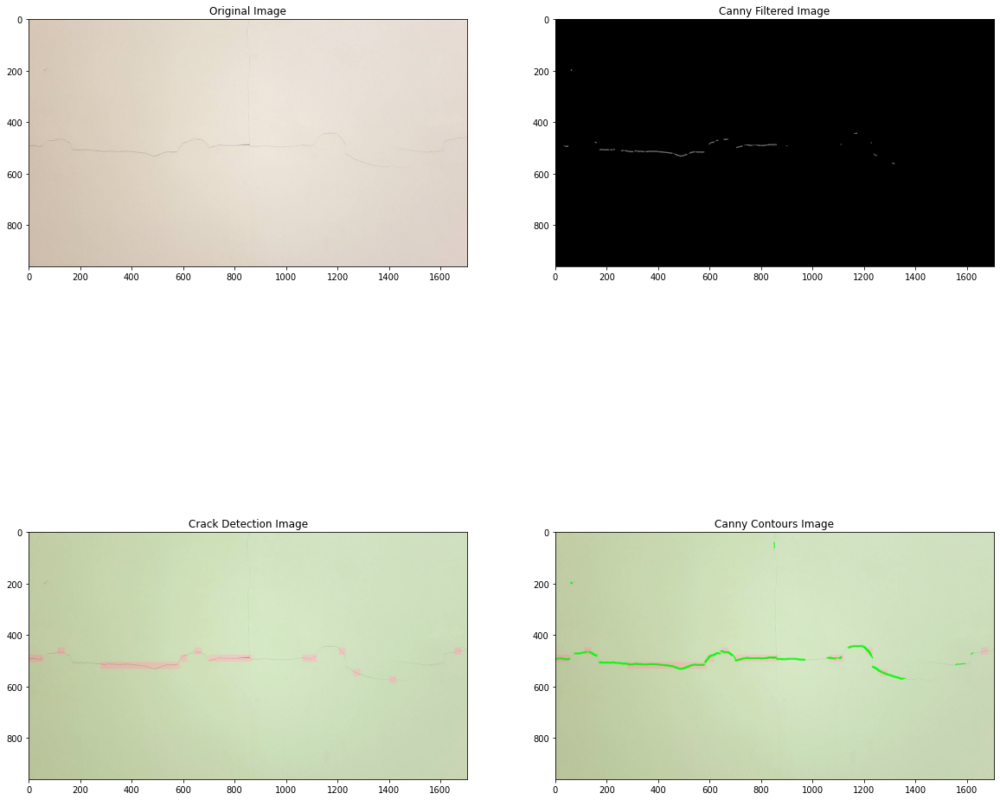

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack12.jpg'
edge_detection(image_PATH, crops_height=28, crops_width=28, low_threshold=30, high_threshold=20)

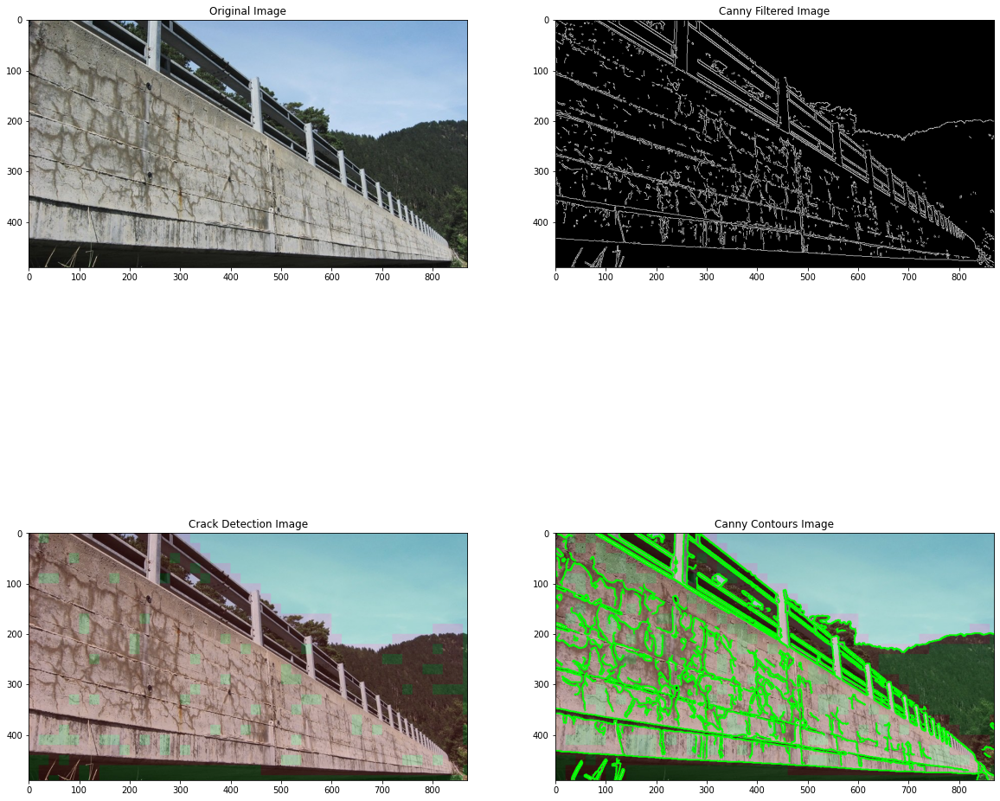

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack13.jpeg'
edge_detection(image_PATH, crops_height=20, crops_width=20, low_threshold=30, high_threshold=100)

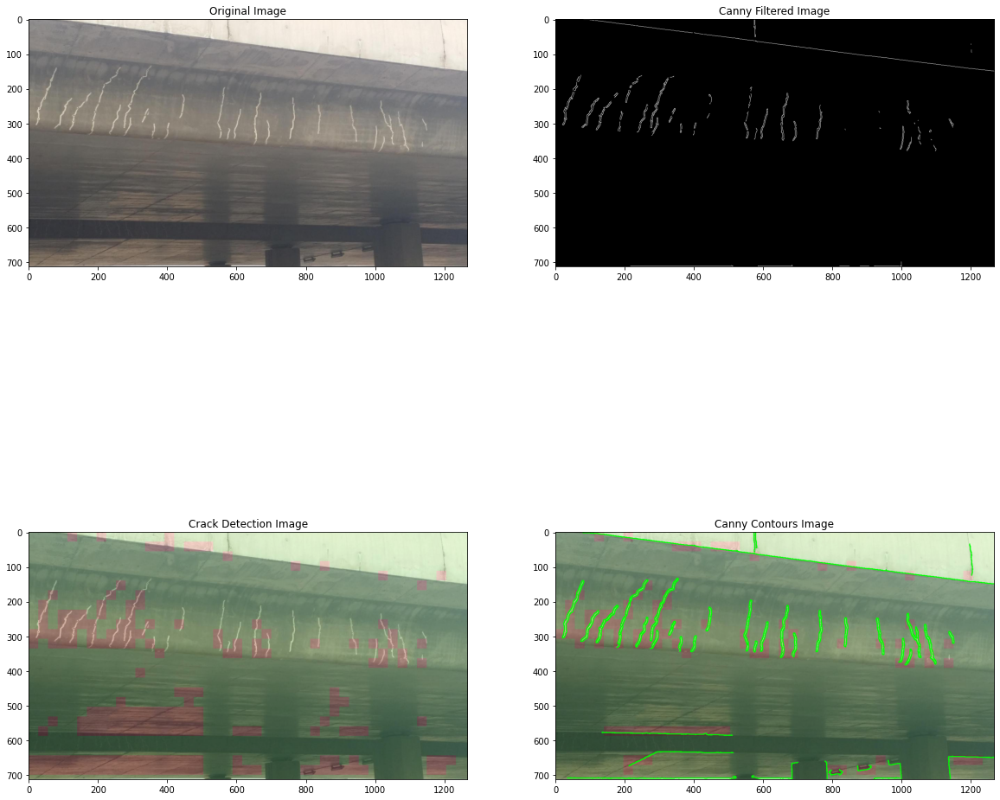

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack14.jpeg'
edge_detection(image_PATH, crops_height=28, crops_width=28, low_threshold=30, high_threshold=75)

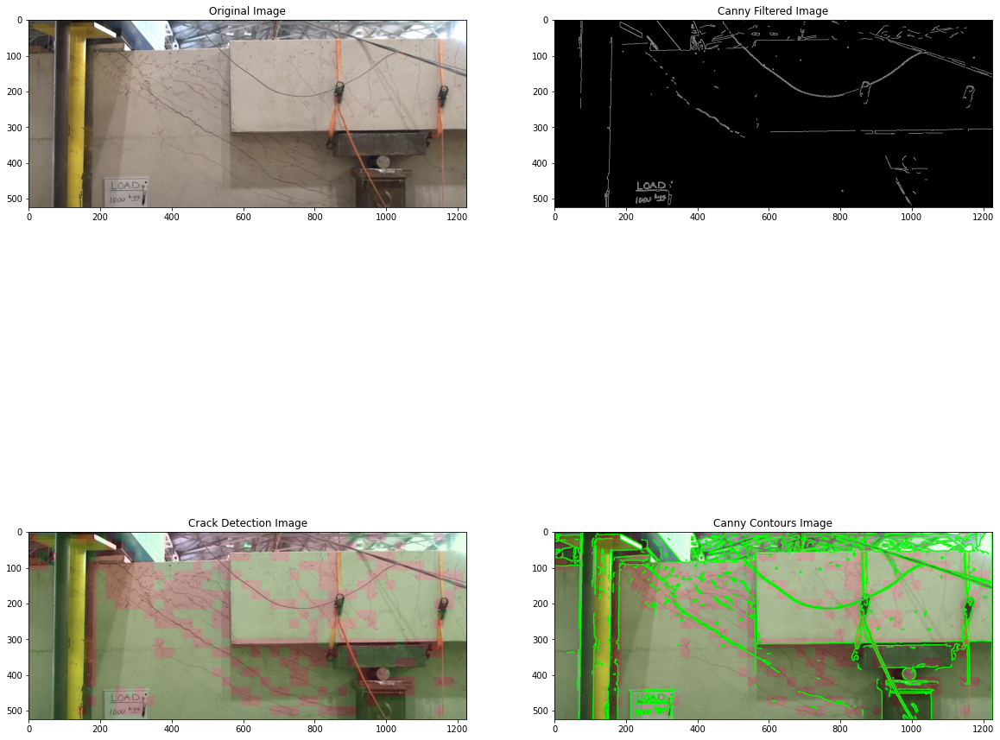

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack15.jpeg'
edge_detection(image_PATH, crops_height=27, crops_width=27, low_threshold=30, high_threshold=45)

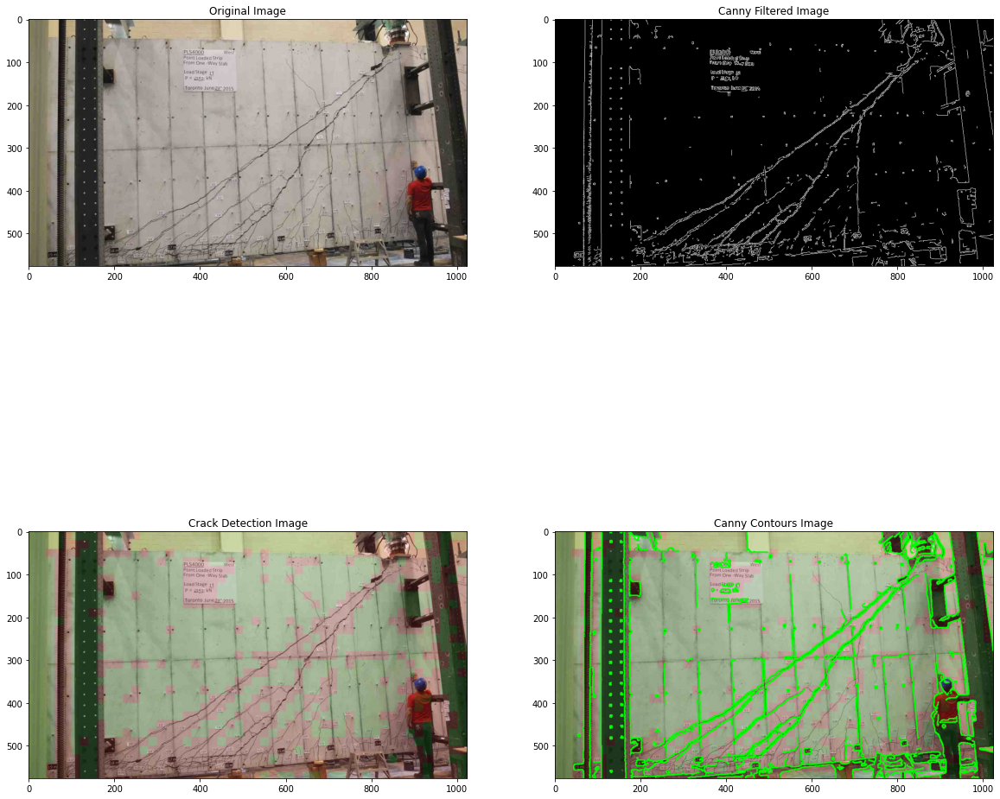

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack16.jpeg'
edge_detection(image_PATH, crops_height=20, crops_width=20, low_threshold=30, high_threshold=90)

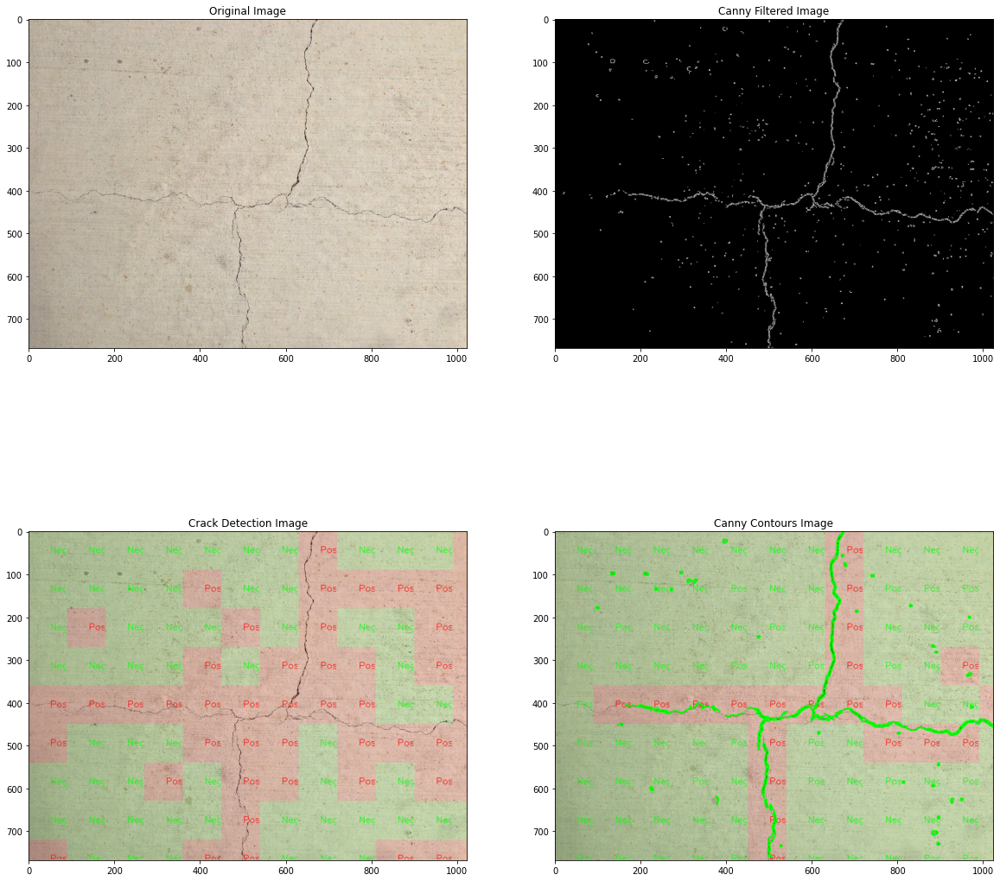

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack1.jpeg'
edge_detection(image_PATH, crops_height=90, crops_width=90, low_threshold=30, high_threshold=70)

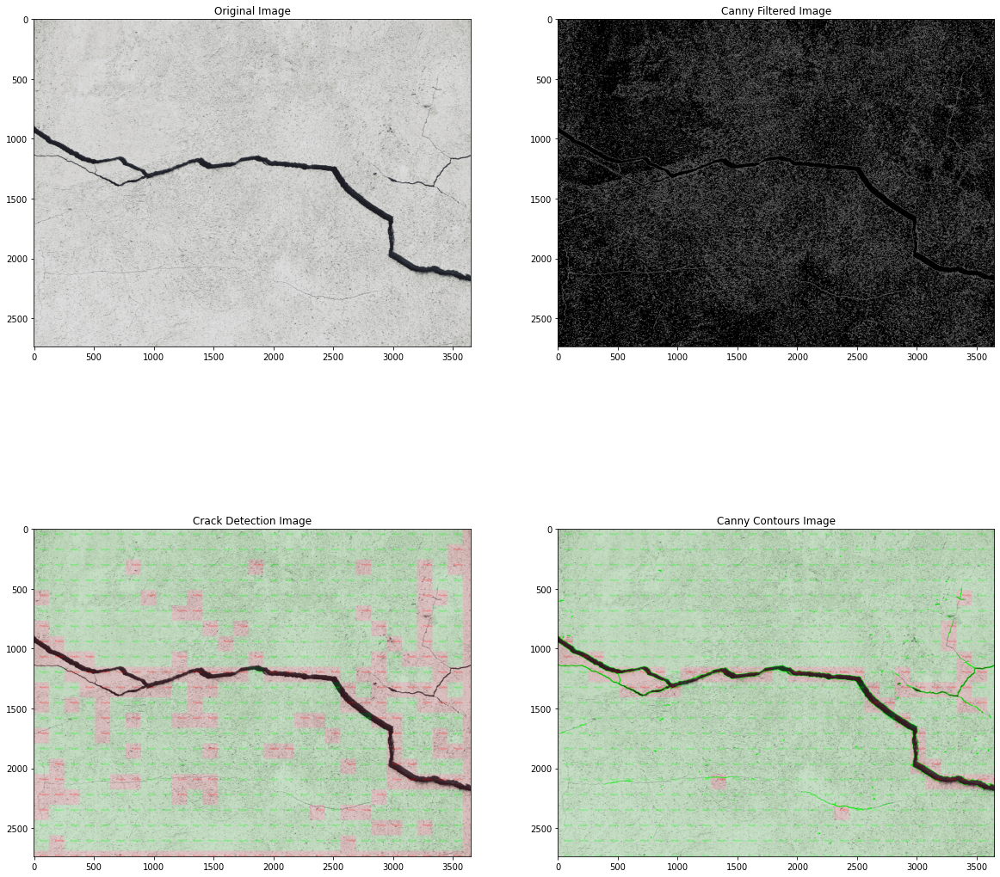

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack2.jpeg'
edge_detection(image_PATH, crops_height=128, crops_width=128, low_threshold=50, high_threshold=250)

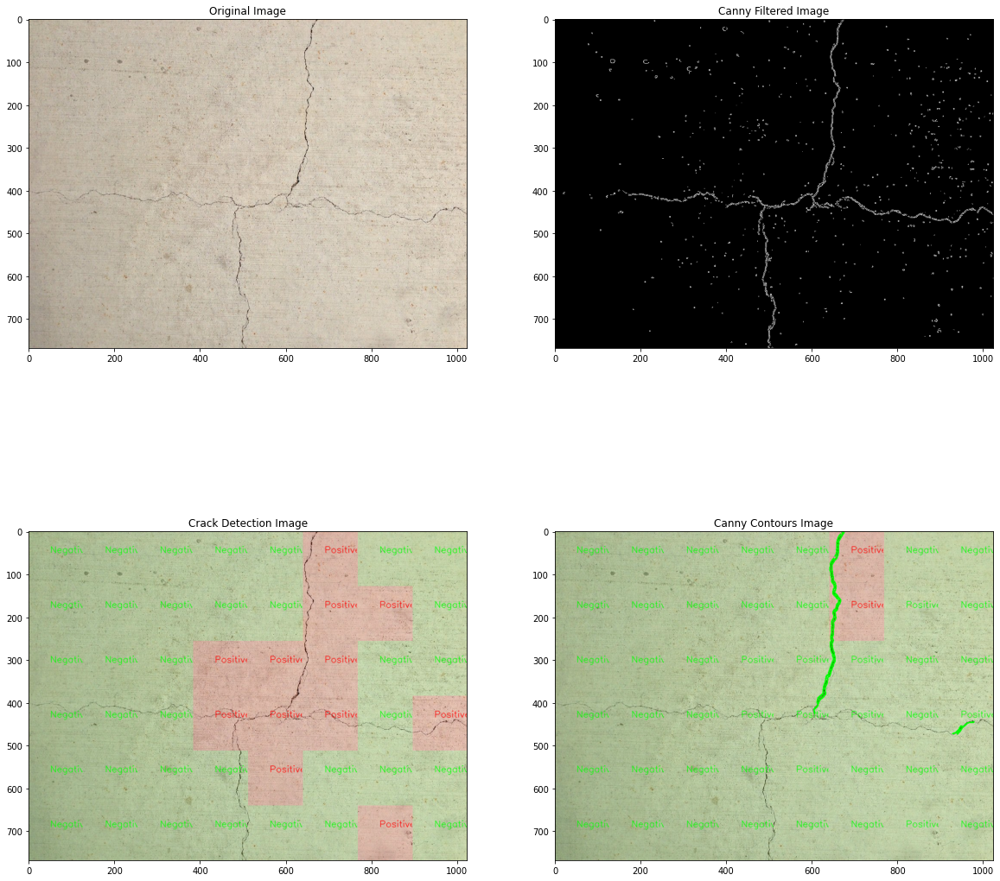

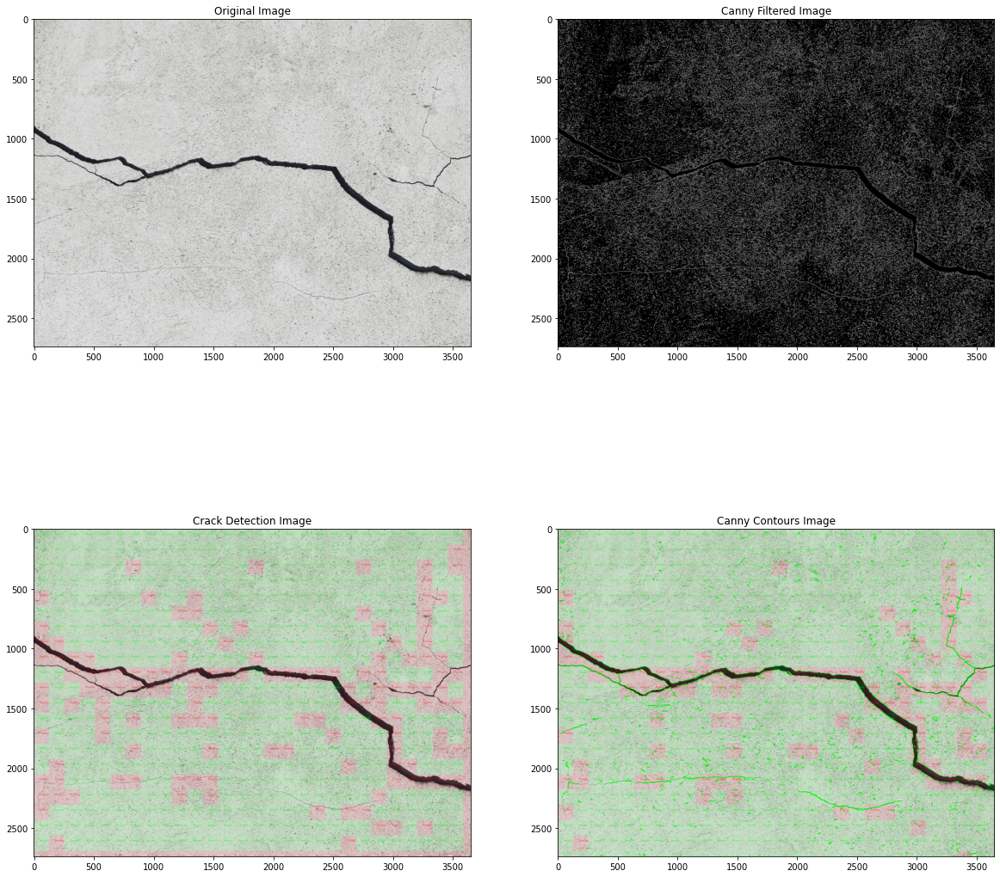

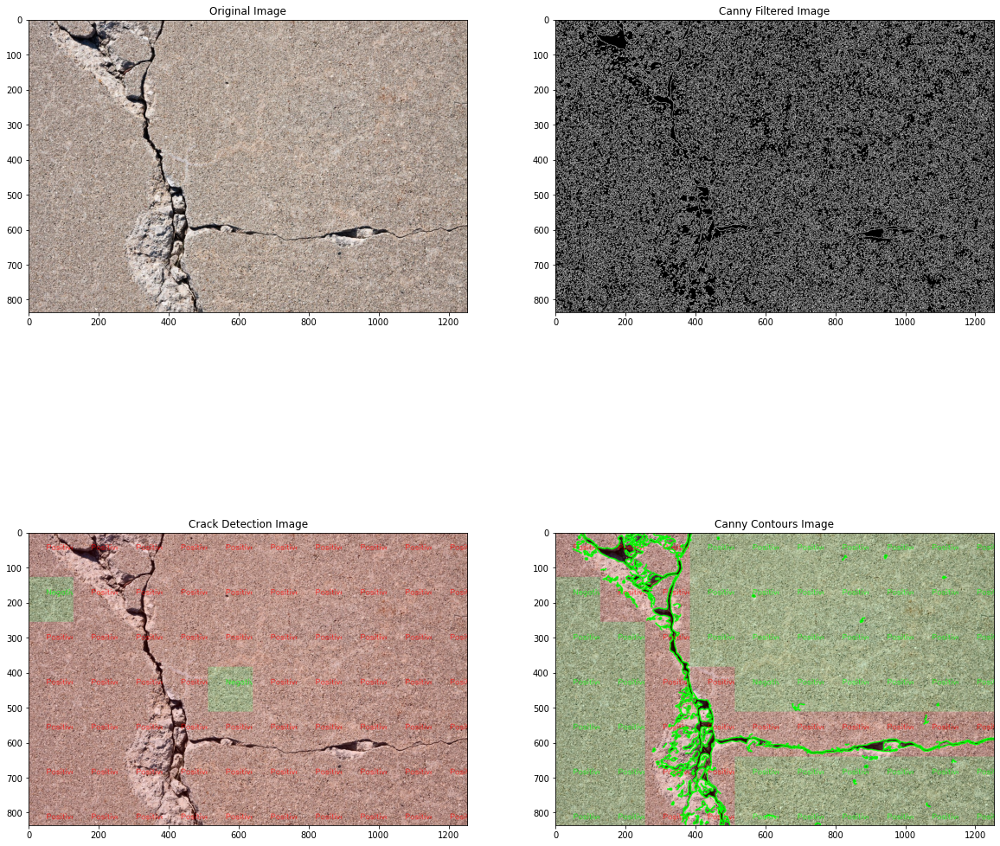

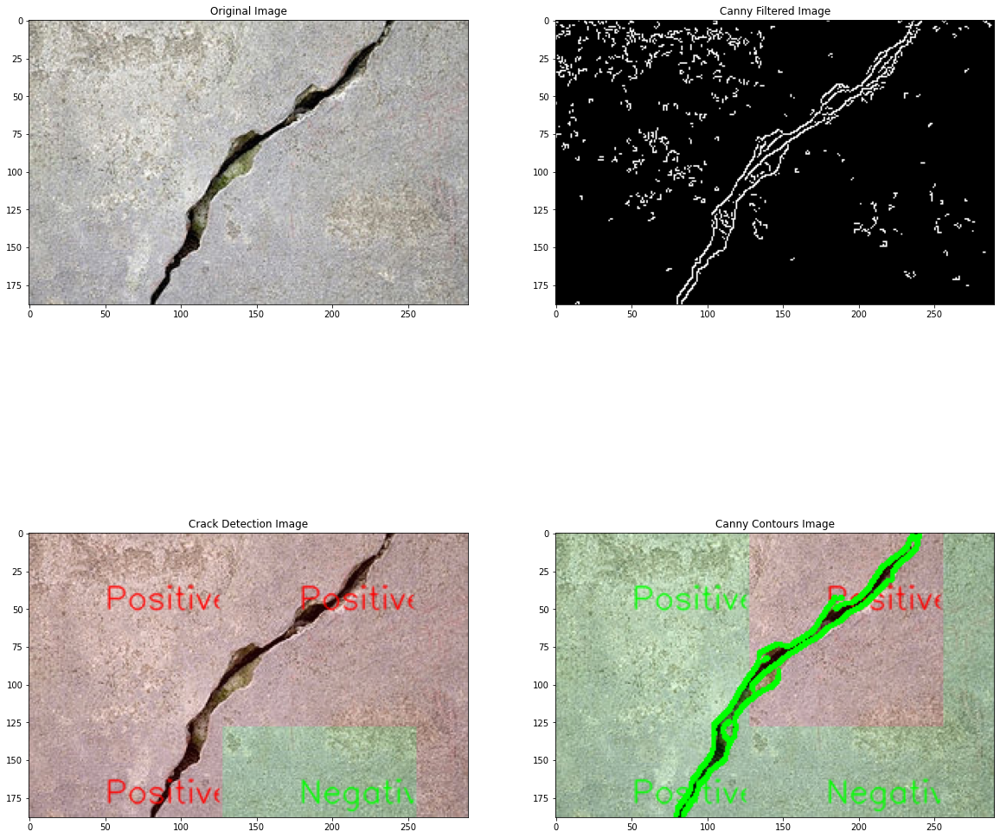

In [ ]:
# Load the image
for _ in range(4):
    image_PATH = PATH + 'real_images/concrete_crack' + str(_+1) +'.jpeg'
    edge_detection(image_PATH, crops_height=128, crops_width=128, low_threshold=50, high_threshold=175)

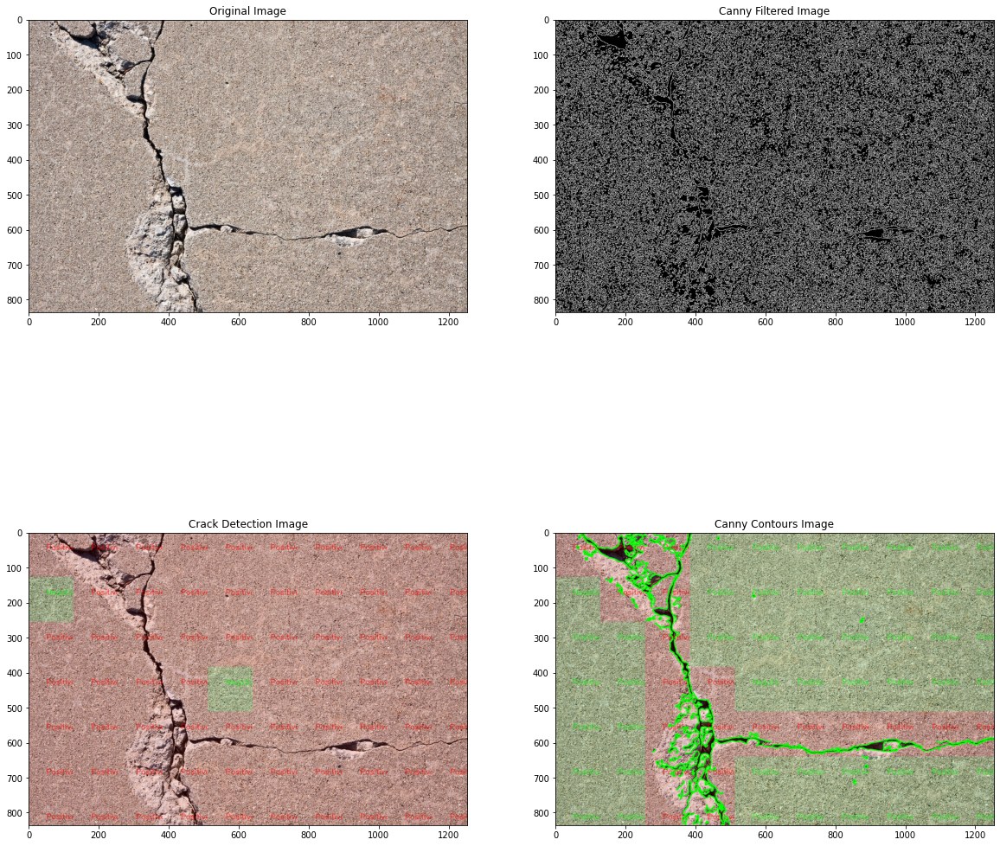

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack3.jpeg'
edge_detection(image_PATH, crops_height=128, crops_width=128, low_threshold=30, high_threshold=200)

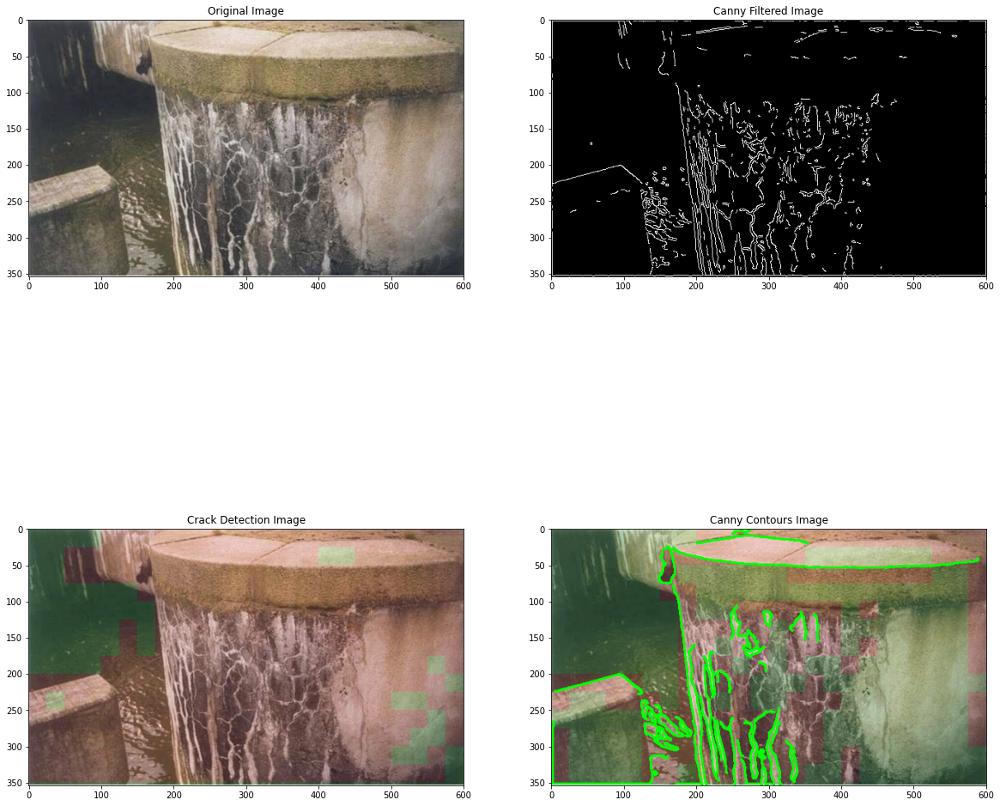

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack5.jpeg'
edge_detection(image_PATH, crops_height=25, crops_width=25, low_threshold=30, high_threshold=170)

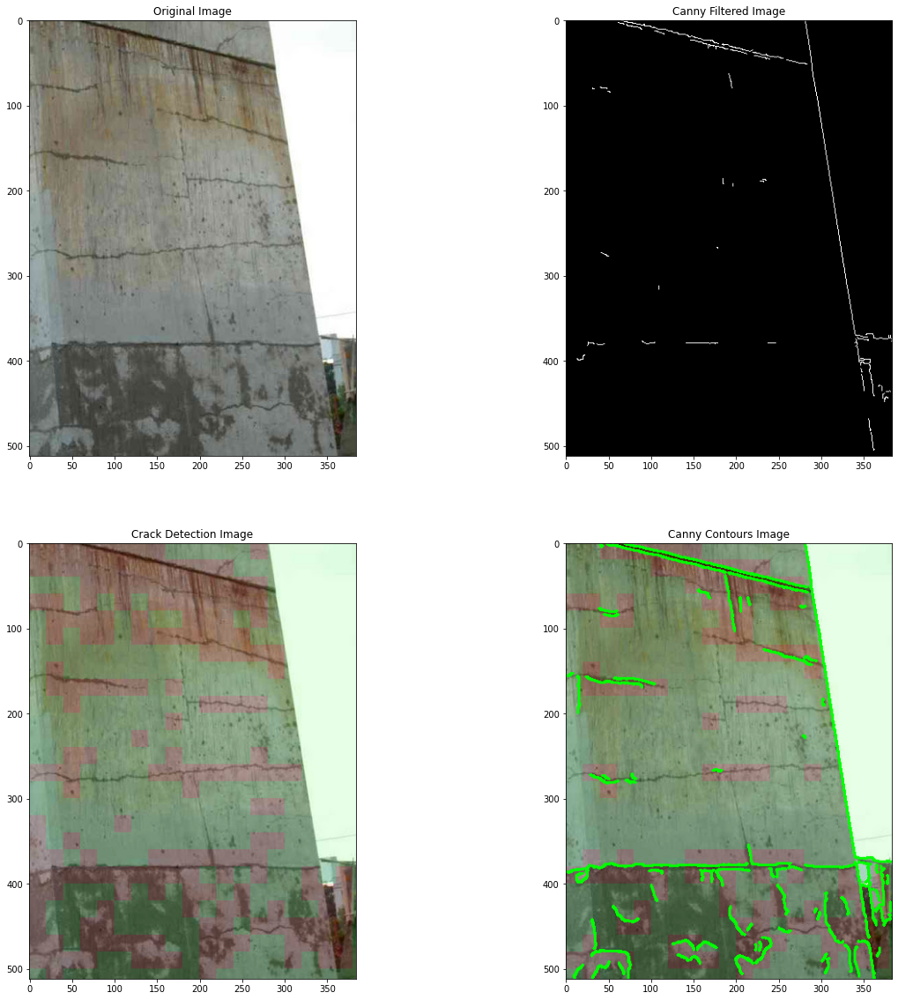

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack6.jpeg'
edge_detection(image_PATH, crops_height=20, crops_width=20, low_threshold=50, high_threshold=80)

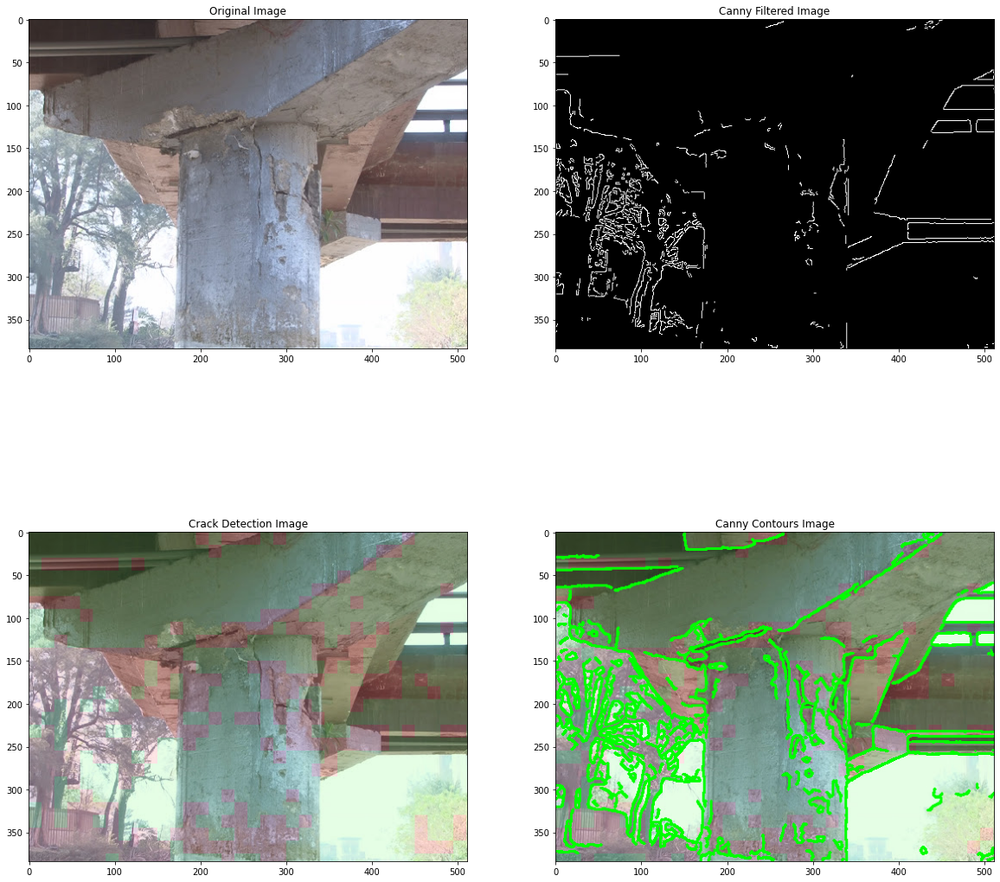

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack7.jpeg'
edge_detection(image_PATH, crops_height=15, crops_width=15, low_threshold=30, high_threshold=60)

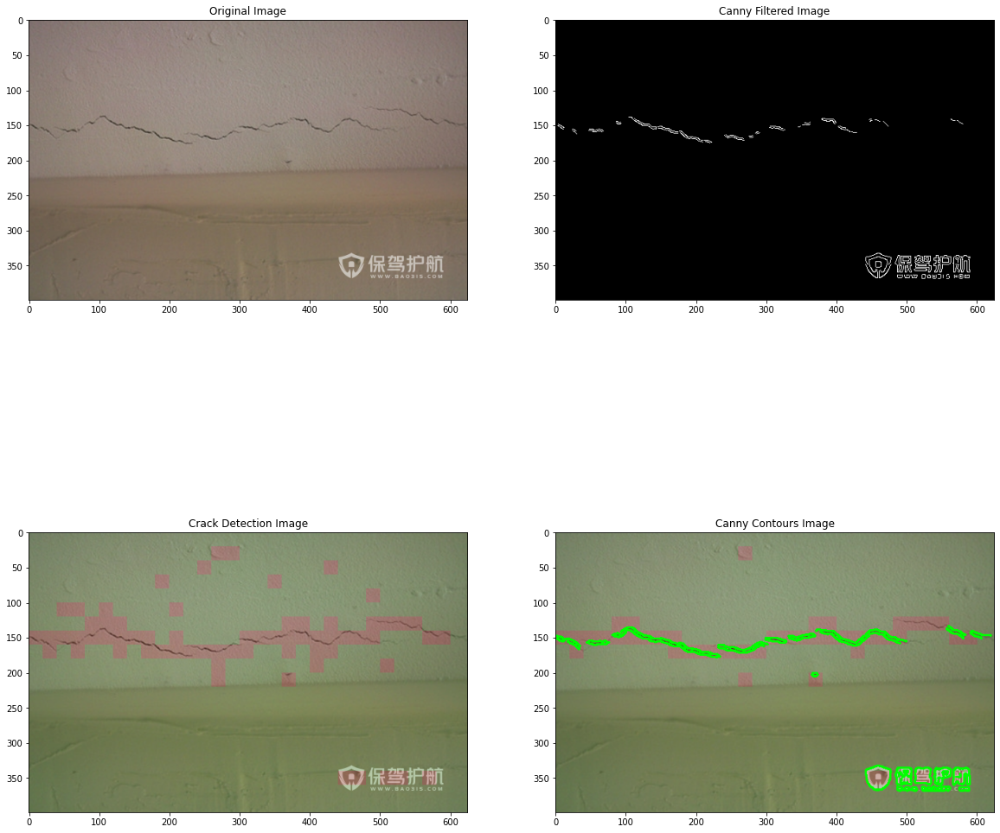

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack8.jpeg'
edge_detection(image_PATH, crops_height=20, crops_width=20, low_threshold=20, high_threshold=50)

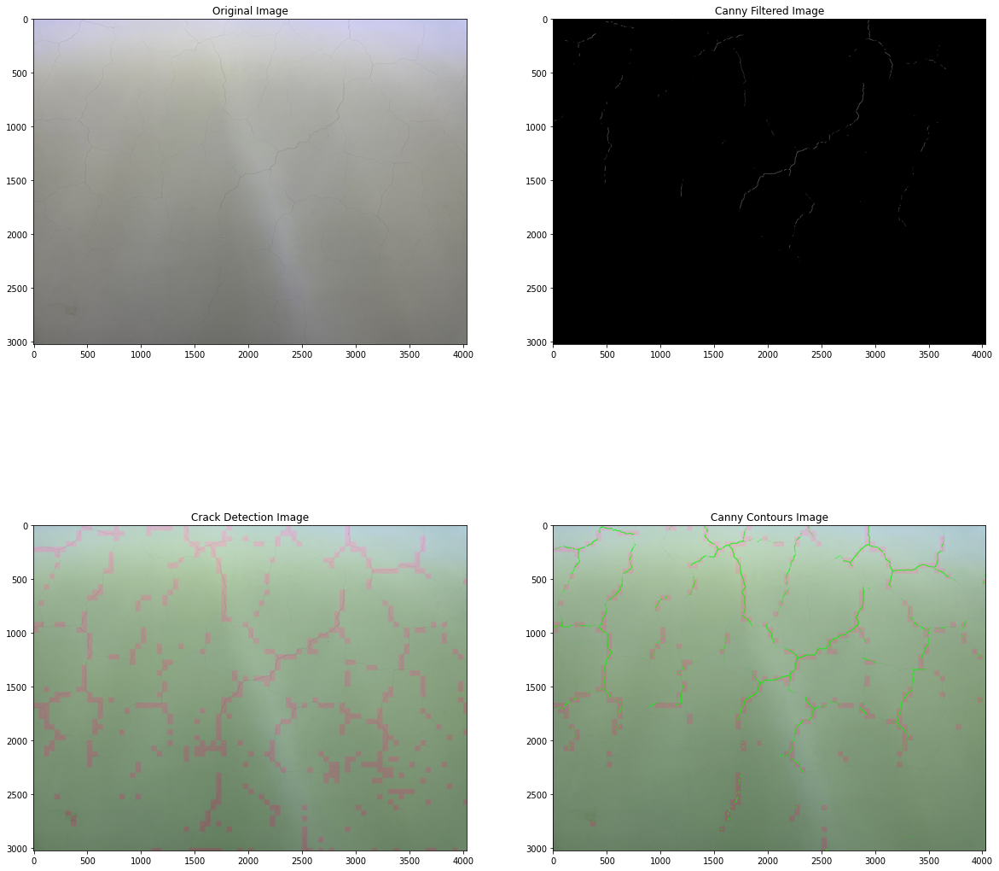

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack9.jpeg'
edge_detection(image_PATH, crops_height=50, crops_width=50, low_threshold=30, high_threshold=30)

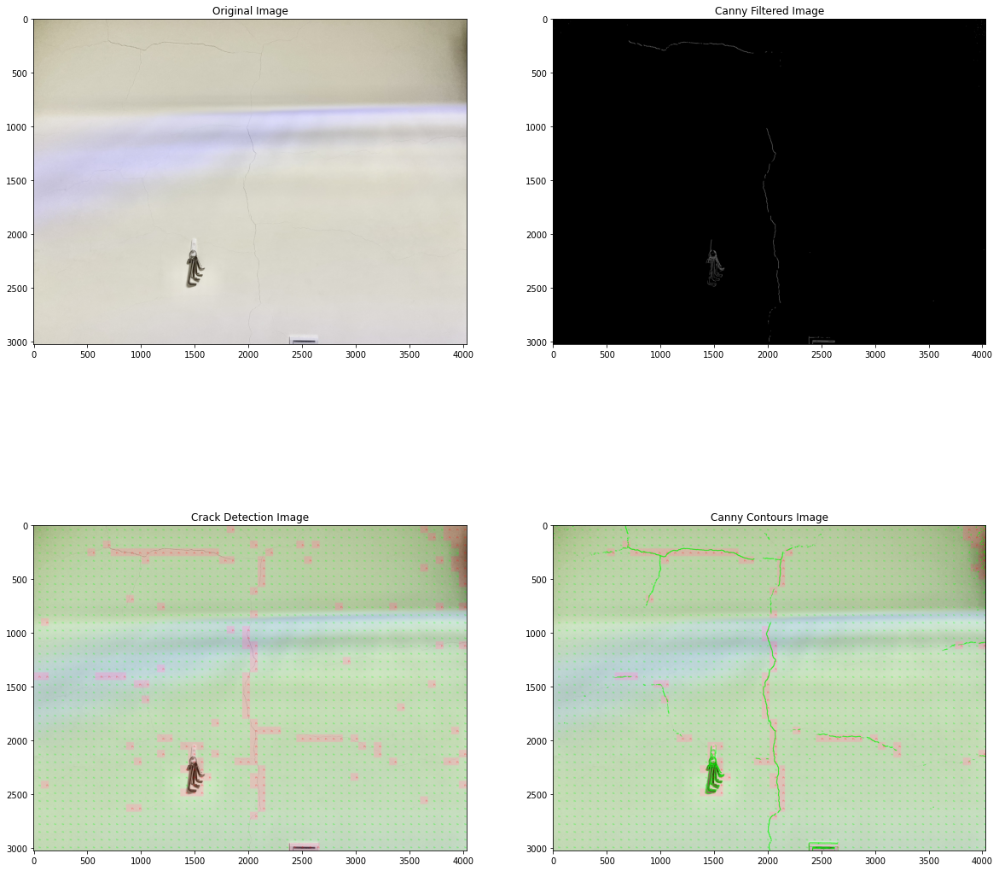

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack10.jpeg'
edge_detection(image_PATH, crops_height=72, crops_width=72, low_threshold=30, high_threshold=20)

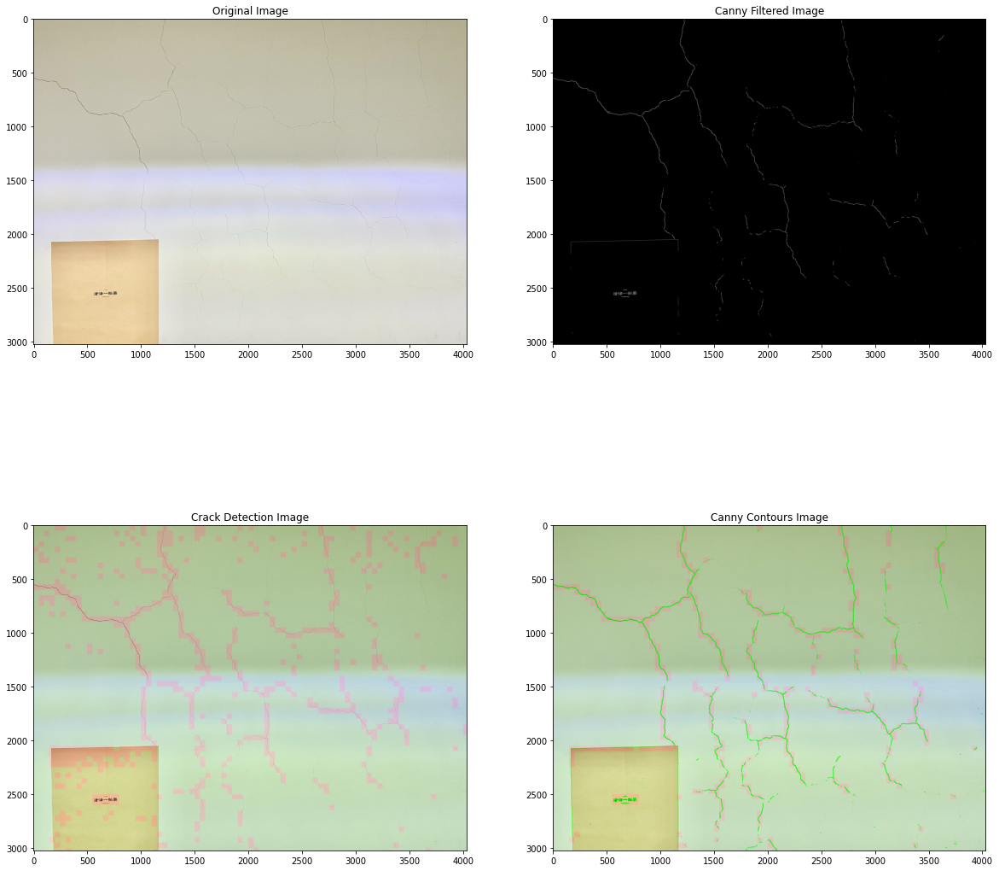

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/concrete_crack11.jpeg'
edge_detection(image_PATH, crops_height=50, crops_width=50, low_threshold=30, high_threshold=30)

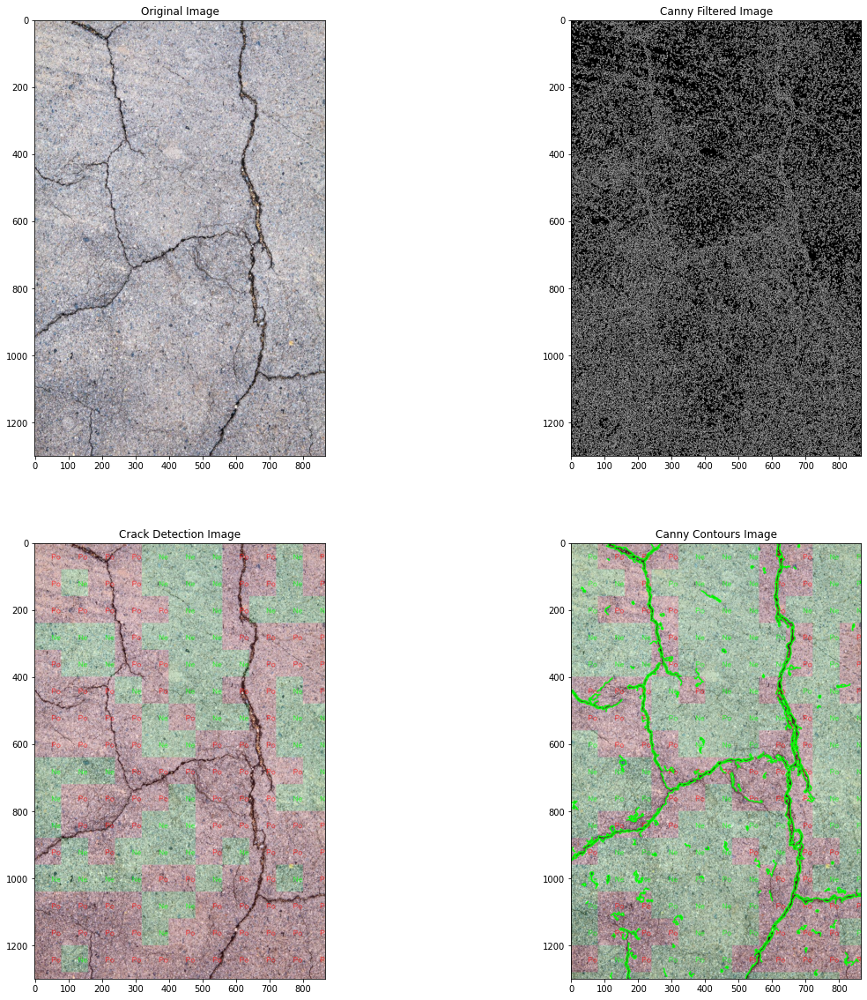

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/road_surface_crack1.jpeg'
edge_detection(image_PATH, crops_height=80, crops_width=80, low_threshold=30, high_threshold=180)

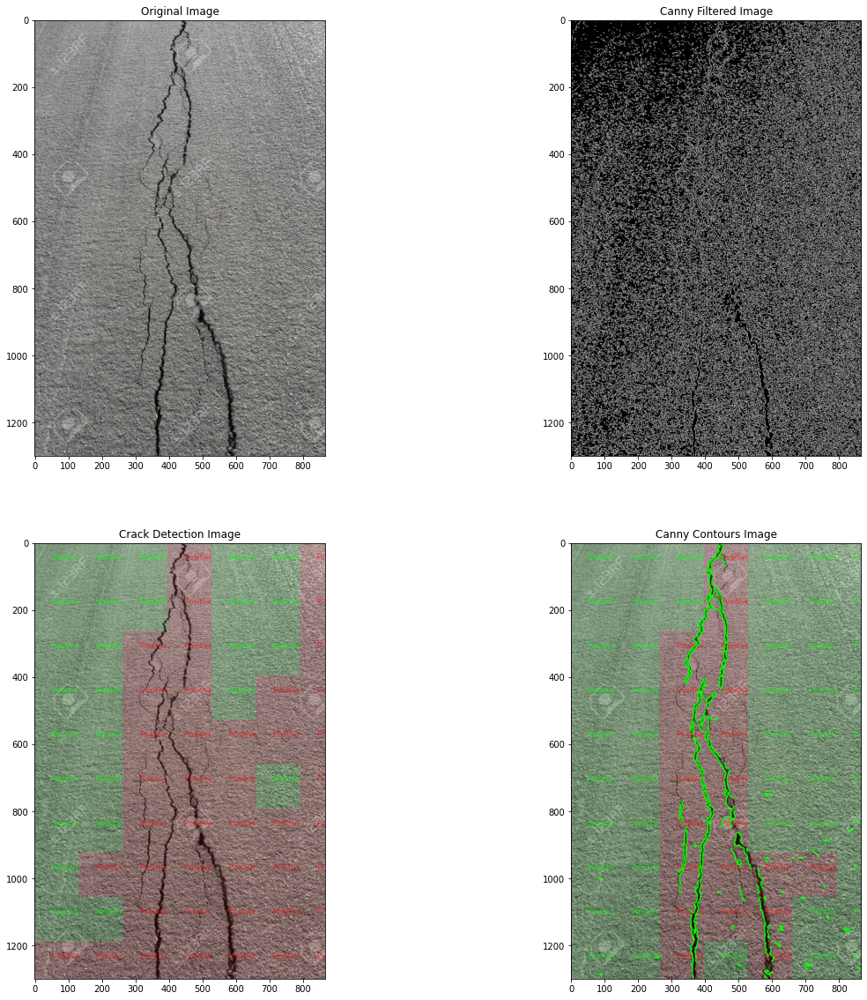

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/road_surface_crack2.jpeg'
edge_detection(image_PATH, crops_height=132, crops_width=132, low_threshold=60, high_threshold=170)

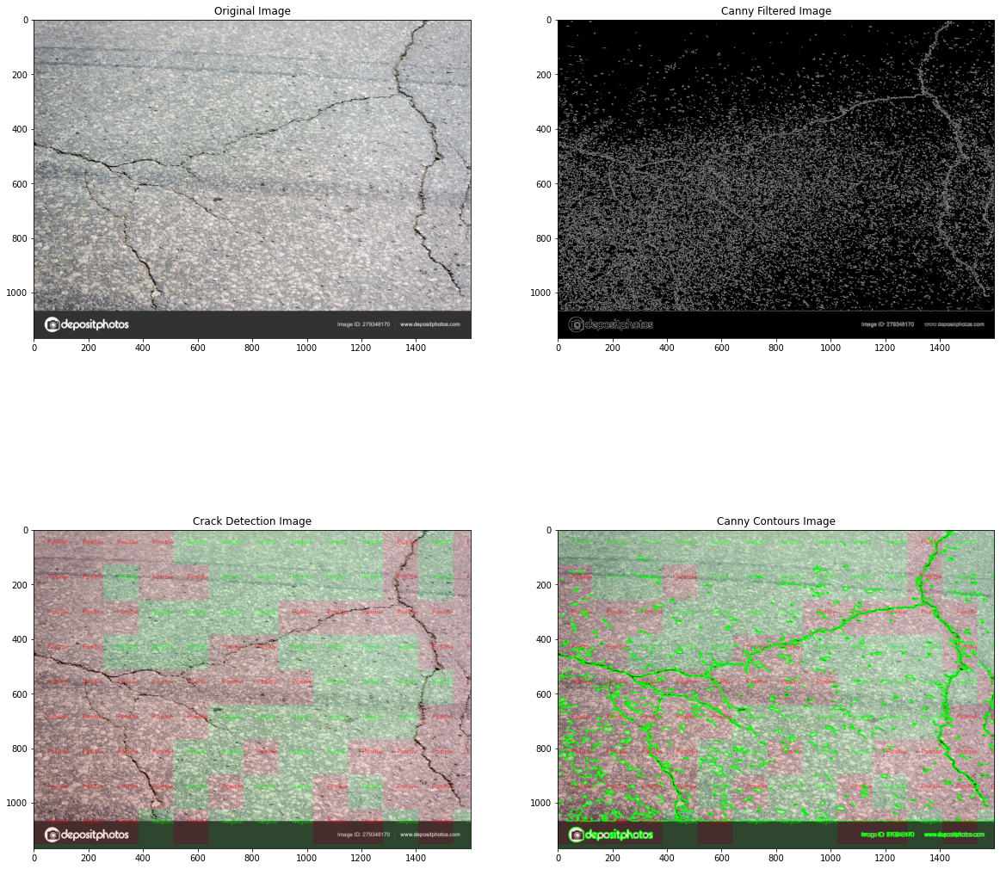

In [ ]:
# Load the image
image_PATH = PATH + 'real_images/road_surface_crack3.jpeg'
edge_detection(image_PATH, crops_height=128, crops_width=128, low_threshold=30, high_threshold=150)